In [24]:
import IPython.display as ipd
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from chord_recognition.utils import read_audio, log_filtered_spectrogram, scale_data, preprocess_spectrogram

%matplotlib inline
plt.rcParams['figure.figsize'] = (14, 5)

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
audio_path = 'data/robbie_williams/mp3/2002-Escapology/13-Cursed.mp3'
audio_waveform, sr = read_audio(audio_path, mono=True)
ipd.Audio(audio_waveform, rate=sr)

In [3]:
n_fft = 8192
hop_length = 4096

# To convert the hop length and frame size to units of seconds:
print(f'Window length: {n_fft/sr:.5}s')
print(f'Hop length: {hop_length/sr:.5}s')
X = librosa.stft(audio_waveform, n_fft=n_fft, hop_length=hop_length)

Window length: 0.18576s
Hop length: 0.09288s


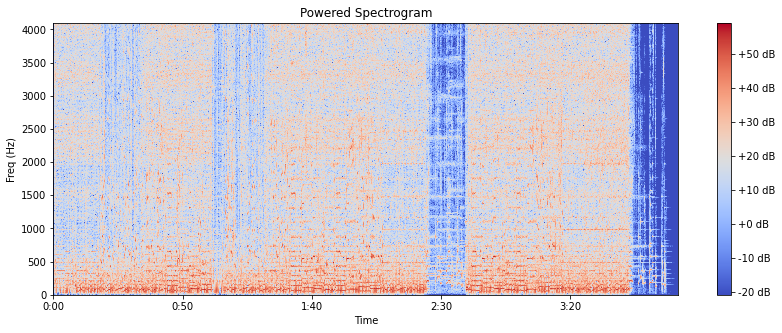

In [4]:
S = librosa.amplitude_to_db(abs(X))
fig, ax = plt.subplots()
img = librosa.display.specshow(S, sr=sr, hop_length=hop_length, x_axis='time', y_axis='linear', ax=ax)
plt.ylim([0, 4096])
ax.set(ylabel='Freq (Hz)', title='Powered Spectrogram')
fig.colorbar(img, ax=ax, format='%+2.0f dB')

In [6]:
print(S.shape)
df = pd.DataFrame(data=S)
df.stack().describe()

(4097, 2604)


count    1.066859e+07
mean     3.265122e-01
std      1.512892e+01
min     -2.084401e+01
25%     -1.350298e+01
50%      1.755851e+00
75%      1.129475e+01
max      5.915599e+01
dtype: float64

In [7]:
Sf = log_filtered_spectrogram(
    audio_waveform, sr, window_size=n_fft, hop_length=hop_length, fmin=65, fmax=2100, num_bands=24)

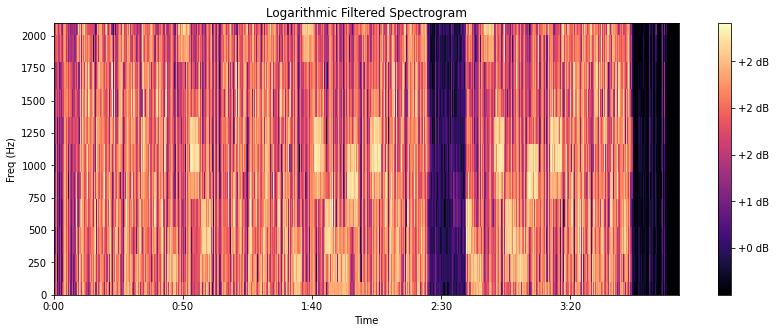

In [8]:
fig, ax = plt.subplots()
img = librosa.display.specshow(Sf, sr=sr, hop_length=hop_length, x_axis='time', y_axis='linear', ax=ax)
plt.ylim([0, 2100])
ax.set(ylabel='Freq (Hz)', title='Logarithmic Filtered Spectrogram')
fig.colorbar(img, ax=ax, format='%+2.0f dB')

In [9]:
print(Sf.shape)
df = pd.DataFrame(data=Sf)
df.stack().describe()

(105, 2604)


count    273420.000000
mean          1.235372
std           0.556958
min           0.000004
25%           0.904841
50%           1.205535
75%           1.590185
max           2.911414
dtype: float64

In [25]:
# Compute normalization factor for each frame
Sf_scaled = preprocess_spectrogram(Sf)
df = pd.DataFrame(data=Sf_scaled)
df.stack().describe()

count    273420.000000
mean          0.600481
std           1.016177
min          -2.281083
25%           0.110073
50%           0.701196
75%           1.255940
max           4.080613
dtype: float64

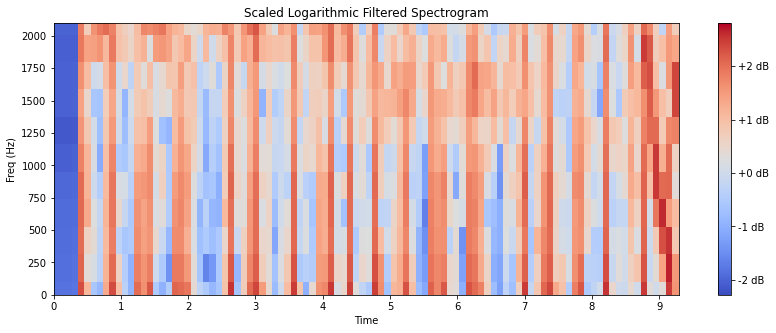

In [26]:
fig, ax = plt.subplots()
img = librosa.display.specshow(Sf_scaled[:, :100], sr=sr, hop_length=hop_length, x_axis='time', y_axis='linear', ax=ax)
plt.ylim([0, 2100])
ax.set(ylabel='Freq (Hz)', title='Scaled Logarithmic Filtered Spectrogram')
fig.colorbar(img, ax=ax, format='%+2.0f dB')

In [56]:
chromafb = librosa.filters.chroma(sr, n_fft, n_chroma=105)

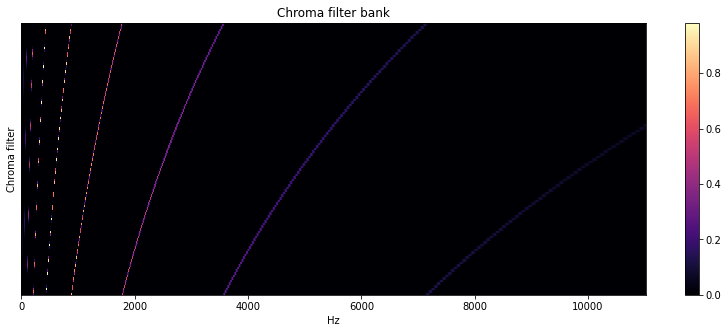

In [59]:
fig, ax = plt.subplots()
img = librosa.display.specshow(chromafb, x_axis='linear', ax=ax)
ax.set(ylabel='Chroma filter', title='Chroma filter bank')
fig.colorbar(img, ax=ax)

In [64]:
#filtered_chroma = np.dot(chromafb, S)
filtered_chroma= Sf

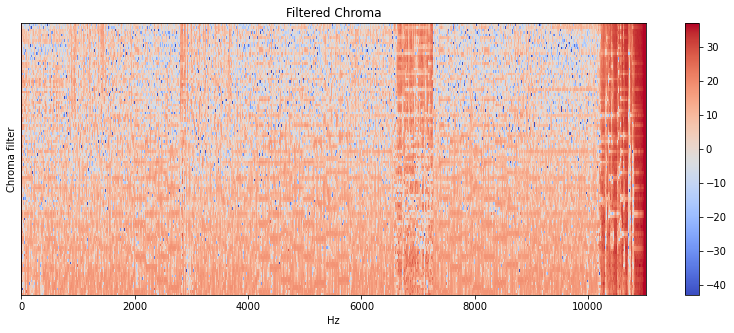

In [65]:
fig, ax = plt.subplots()
img = librosa.display.specshow(filtered_chroma, x_axis='linear', ax=ax)
ax.set(ylabel='Chroma filter', title='Filtered Chroma')
fig.colorbar(img, ax=ax)